<a href="https://colab.research.google.com/github/HeyLaxmi/DS-Unit-1-Sprint-1-Dealing-With-Data/blob/master/Copy_of_KLAS_Applicant_Zip_Codes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Import/Install Necessary Python Libraries

In [0]:
# For CSV data wrangling
import pandas as pd

# Core Plotting Functionality
import matplotlib.pyplot as plt

# Required by geopandas
!pip install descartes
from descartes import PolygonPatch

# Can create a heatmap from a shapefile
!pip install geopandas
import geopandas as gpd

# Use points to identify centroid of each polygon
from shapely.geometry import Point

# Auto-adjust text so that Zip Code NAMES do not overlap
!pip install adjustText
import adjustText as aT

## Settings for number of rows and columns to display in output

In [0]:
# Set Pandas Display Options for Rows and Columns
pd.set_option('display.max_rows', 200)
pd.set_option('display.max_columns', 500)

## Upload 2014_2019_Applicant_Data.csv to notebook

In [0]:
# Use the prompt below to upload a file from your machine.
from google.colab import files
files.upload()

Saving 2014_2019_Applicant_Data.csv to 2014_2019_Applicant_Data.csv


{'2014_2019_Applicant_Data.csv': b'Last Name,First Name,Prospect ID,Email,Phone,Address,City,State,Postal,Job,Job ID,Jazz Job ID,Job Department,Hiring Manager,Hiring Manager ID,Job Status,Workflow,Jazz Workflow ID,Workflow Status,Job City,Job State,Job Postal,Job Experience Level,Full.,Job Notes,Date Applied,Referrer,Source,Rating,WMYU?,Categories,References,LinkedIn,"Website, Blog, Portfolio",Twitter,Earliest Start Date,Available Weekends,Available Evenings,Available Overtime,Languages,Desired Salary,Drivers License,Commercial Drivers License,Can Relocate,Citizen/Employment Status,Highest Education,College/University,Grade Point Avg,Age 18+,Pilot - Flight Hours,Pilot - Grade/Ratings,Felony Conviction,Felony Explanation,EEO Category,EEO Sex,EEO Race,EEO Disability,EEOC Veteran Status,EEOC Disability Status\r\nGomez,Bradley,prospect_20160315202852_MCXXO7FIK0YJFUWB,gomezbradley@gmail.com,407-310-4950,,,,,Healthcare Transparency Researcher,,job_20160129190130_HK9QIXUHAH1FT3P1,Research,Dus

## Read in Applicant Data 

With this data we will:

- Generate a CSV that has counts of unique applicants by Zip Code
- Generate a Heat Map (choropleth) of applicants by Zip Code


In [0]:
# Read in CSV
df = pd.read_csv('2014_2019_Applicant_Data.csv')

# Look at the number of rows and columns of the CSV
print(df.shape)

# Look at the first 5 rows of the CSV
df.head()

(8741, 59)


,Last Name,First Name,Prospect ID,Email,Phone,Address,City,State,Postal,Job,Job ID,Jazz Job ID,Job Department,Hiring Manager,Hiring Manager ID,Job Status,Workflow,Jazz Workflow ID,Workflow Status,Job City,Job State,Job Postal,Job Experience Level,Full.,Job Notes,Date Applied,Referrer,Source,Rating,WMYU?,Categories,References,LinkedIn,"Website, Blog, Portfolio",Twitter,Earliest Start Date,Available Weekends,Available Evenings,Available Overtime,Languages,Desired Salary,Drivers License,Commercial Drivers License,Can Relocate,Citizen/Employment Status,Highest Education,College/University,Grade Point Avg,Age 18+,Pilot - Flight Hours,Pilot - Grade/Ratings,Felony Conviction,Felony Explanation,EEO Category,EEO Sex,EEO Race,EEO Disability,EEOC Veteran Status,EEOC Disability Status
0,Gomez,Bradley,prospect_20160315202852_MCXXO7FIK0YJFUWB,gomezbradley@gmail.com,407-310-4950,NaN,NaN,NaN,NaN,Healthcare Transparency Researcher,NaN,job_20160129190130_HK9QIXUHAH1FT3P1,Research,Dusty Fenwick,usr_20160112164244_Y0A47NXGRSHASYEP,Closed,Advanced Workflows - Researcher,workflow_20160129190130_HRRSJSLQ2KSTZLIF,Not A Fit,Orem,UT,84097.0,Entry Level,Full Time,NaN,12/3/2014,NaN,Data Import,NaN,NaN,NaN,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,Administrative Support Workers,No Answer,No Answer,No Answer,No Answer,No Answer
1,Baker,Scott,prospect_20160315202854_FXUPPQXOWSIACCJG,scottbaker21@mac.com,(801) 949-4610,3006 W 13680 S,Riverton,UT,84065,Online Content Manager,NaN,job_20160126232610_RJKPS1OA7PYFTMWV,Marketing,Dusty Fenwick,usr_20160112164244_Y0A47NXGRSHASYEP,Cancelled,Advanced Workflows - Content Marketing Specialist,workflow_20160126232610_3TIFMLYJQHJOA76Z,Not a Fit,Orem,UT,84097.0,Mid Level,Full Time,NaN,12/4/2014,NaN,Data Import,NaN,NaN,NaN,--,http://www.linkedin.com/pub/scott-baker/3/200/...,--,--,--,--,--,--,--,"55,000 / Yr",--,--,--,--,--,--,--,--,--,--,--,--,Professionals,Male,White (Not Hispanic),No Answer,No Answer,No Answer
2,Baker,Scott,prospect_20160315212957_THZ7OLS9POXS6EKC,scottbaker21@mac.com,(801) 949-4610,3006 W 13680 S,Riverton,UT,84065,Online Content Manager,NaN,job_20160126232610_RJKPS1OA7PYFTMWV,Marketing,Dusty Fenwick,usr_20160112164244_Y0A47NXGRSHASYEP,Cancelled,Advanced Workflows - Content Marketing Specialist,workflow_20160126232610_3TIFMLYJQHJOA76Z,Not a Fit,Orem,UT,84097.0,Mid Level,Full Time,NaN,12/4/2014,NaN,Data Import,NaN,NaN,NaN,--,http://www.linkedin.com/pub/scott-baker/3/200/...,--,--,--,--,--,--,--,"55,000 / Yr",--,--,--,--,--,--,--,--,--,--,--,--,Professionals,Male,White (Not Hispanic),No Answer,No Answer,No Answer
3,Christiansen,Craig,prospect_20160315213000_SDPX5T9EKA4462MP,craigwc75@gmail.com,(818) 618.8211,NaN,NaN,NaN,NaN,Healthcare Transparency Researcher,NaN,job_20160129190130_HK9QIXUHAH1FT3P1,Research,Dusty Fenwick,usr_20160112164244_Y0A47NXGRSHASYEP,Closed,Advanced Workflows - Researcher,workflow_20160129190130_HRRSJSLQ2KSTZLIF,Not A Fit,Orem,UT,84097.0,Entry Level,Full Time,NaN,12/4/2014,NaN,Data Import,NaN,NaN,NaN,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,Administrative Support Workers,No Answer,No Answer,No Answer,No Answer,No Answer
4,Davis,Matthew,prospect_20160315213002_ISVJVWIEKQRQNOWJ,opaco40@yahoo.com,801-5036739,NaN,NaN,NaN,NaN,Online Content Manager,NaN,job_20160126232610_RJKPS1OA7PYFTMWV,Marketing,Dusty Fenwick,usr_20160112164244_Y0A47NXGRSHASYEP,Cancelled,Advanced Workflows - Content Marketing Specialist,workflow_20160126232610_3TIFMLYJQHJOA76Z,Not a Fit,Orem,UT,84097.0,Mid Level,Full Time,NaN,12/4/2014,NaN,Data Import,NaN,NaN,NaN,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,--,Professionals,No Answer,No Answer,No Answer,No Answer,No Answer


## Drop all columns except for "Postal" (zip code) and "Email" 

We are assuming that email can serve as a unique identifier for each applicant.

We start off with 8,741 rows of data from the initial CSV file.

In [0]:
# Make a copy of the original data that retains only "Postal" and "Email"
zipcodes = df[['Postal', 'Email']].copy()

# Look at shape of the new dataframe
print(zipcodes.shape)

# Look at the first 5 rows
zipcodes.head()

(8741, 2)


,Postal,Email
0,NaN,gomezbradley@gmail.com
1,84065,scottbaker21@mac.com
2,84065,scottbaker21@mac.com
3,NaN,craigwc75@gmail.com
4,NaN,opaco40@yahoo.com


## Drop rows that do not have a Postal Code

1526 rows did not contain a Postal Code. This is 1526/8741 or about 17.46% of the original rows.

In [0]:
# Drop NaN values
zipcodes = zipcodes.dropna()

# Look at Dataframe shape
print(zipcodes.shape)

(7215, 2)


## Drop Duplicate rows

This assumes that we do not want to count an applicant twice if they have applied multiple times using the same email address and Postal Code.

This removes another 1151 rows of data. The remaining rows should be "unique applicants" according to our definition. 

In [0]:
# Drop Duplicate Rows
zipcodes = zipcodes.drop_duplicates()

# Look at the shape of the data
print(zipcodes.shape)

# Look at the first 5 rows. 
zipcodes.head()

(6064, 2)


,Postal,Email
1,84065,scottbaker21@mac.com
7,84508,lcoltonj@gmail.com
8,84606,teneallet@gmail.com
9,94604,hlmauga@gmail.com
10,84606,skylerwrites@gmail.com


## Look at applicant counts by most common Postal Code.

You'll notice that the output here truncates somewhere in the middle. To view more rows adjust the "Pandas Display Options" at the top of the notebook and then re-run the cell that sets those display settings, and then come back and run this cell.

In [0]:
zipcodes['Postal'].value_counts()

84606                        539
84604                        516
84058                        484
84057                        422
84601                        327
84062                        302
84097                        253
84043                        232
84003                        206
84663                        172
84660                        171
84045                        107
84651                         81
84005                         80
84020                         68
84065                         65
84095                         65
84042                         55
84096                         47
84664                         45
84092                         44
84121                         42
84047                         36
84004                         36
(No Postal Code Provided)     36
84653                         36
84655                         31
84106                         30
84123                         29
84321                         28
84102     

## Remove Non-Utah Zip Codes

Upon manual examination of the zip code counts we noticed that there were very few zip codes outside of Utah that had significant numbers of applicants. All Utah zip codes begin with the digits -84.

Due to this, we will remove any zip codes that do not begin with the digits 84 so as to make it possible to create a heat map of Utah zip codes.

In [0]:
# Remove Zip Codes that do not begin with the digits 84
utah = zipcodes[zipcodes['Postal'].str.contains('^84')] 

# Look at the number of rows and columns
print(utah.shape)

# Look at the first 5 rows
utah.head()

(5345, 2)


,Postal,Email
1,84065,scottbaker21@mac.com
7,84508,lcoltonj@gmail.com
8,84606,teneallet@gmail.com
10,84606,skylerwrites@gmail.com
11,84045,blds2@hotmail.com


## Remove Postal Codes that do not have 5 digits

This only removes 8 rows of data.

In [0]:
# Remove Zip Codes that do not have 5 digits.
utah = utah[utah['Postal'].str.contains('^[0-9]{5}$')] 

print(utah.shape)

(5337, 2)


# Create final tabulation of Utah applicants by Zip Code

In [0]:
# Tabulate Unique Applicants by Zip Code.
utah_applicants = utah['Postal'].value_counts().rename_axis('zip_code').reset_index(name='applicants')

# Look at rows and columns
print(utah_applicants.shape)

# Look at the counts for every Zip Code
utah_applicants.head(144)

(144, 2)


,zip_code,applicants
0,84606,539
1,84604,516
2,84058,484
3,84057,422
4,84601,327
5,84062,302
6,84097,253
7,84043,232
8,84003,206
9,84663,172


## Remove non-existant 5 digit '84 zipcodes'

5 zipcodes remained that do not exist in the state of Utah, we will remove them directly. They are:

- 84506
- 84507
- 84508
- 84705
- 84907

In [0]:
# Remove erroneous zip codes
utah_applicants = utah_applicants[~(utah_applicants['zip_code'] == '84506') 
                                 & ~(utah_applicants['zip_code'] == '84507') 
                                 & ~(utah_applicants['zip_code'] == '84508') 
                                 & ~(utah_applicants['zip_code'] == '84705') 
                                 & ~(utah_applicants['zip_code'] == '84907')]
print(utah_applicants.shape)
utah_applicants.head()

(139, 2)


,zip_code,applicants
0,84606,539
1,84604,516
2,84058,484
3,84057,422
4,84601,327


## Export Utah Applicant Counts to CSV

In [0]:
utah_applicants.to_csv("KLAS_utah_applicants_by_zip_code.csv")

# Next we will create a heat map to show the results visually

In order to create the heatmap you must upload the following files from the ZipCodes folder:

- ZipCodes.cpg
- ZipCodes.dbf
- ZipCodes.prj
- ZipCodes.sbn
- ZipCodes.sbx
- ZipCodes.shp
- ZipCodes.shp.xml
- ZipCodes.shx

In [0]:
files.upload()

Saving ZipCodes.shp to ZipCodes.shp
Saving ZipCodes.shx to ZipCodes.shx
Saving ZipCodes.dbf to ZipCodes.dbf
Saving ZipCodes.sbn to ZipCodes.sbn
Saving ZipCodes.sbx to ZipCodes.sbx
Saving ZipCodes.prj to ZipCodes.prj
Saving ZipCodes.cpg to ZipCodes.cpg


{'ZipCodes.cpg': b'UTF-8',
 'ZipCodes.dbf': b'\x03w\x02\x1a-\x01\x00\x00\xe1\x00^\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00ZIP5\x00\x00\x00\x00\x00\x00\x00C\x00\x00\x00\x00\xfe\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00COUNTYNBR\x00\x00C\x00\x00\x00\x00\x02\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00NAME\x00\x00\x00\x00\x00\x00\x00C\x00\x00\x00\x002\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00SYMBOL\x00\x00\x00\x00\x00N\x00\x00\x00\x00\x05\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00SHAPE_Leng\x00F\x00\x00\x00\x00\x13\x0b\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00SHAPE_Area\x00F\x00\x00\x00\x00\x13\x0b\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\r 84621                                                                                                                                                                                                                 

# Read in Shapefile for mapping and rename 'ZIP5' column to 'zip_code'

In [0]:
# Read in main Shapefile
zipcode_shapefile = gpd.read_file('ZipCodes.shp' )

# Rename 'ZIP5' column to have the same column header as utah_applicants
# This will make it much easier to merge the two dataframes.
zipcode_shapefile = zipcode_shapefile.rename(columns={'ZIP5': 'zip_code'})

# Look at the number of rows and columns
print(zipcode_shapefile.shape)

# Look at the first 5 lines
zipcode_shapefile.head() 

(301, 7)


,zip_code,COUNTYNBR,NAME,SYMBOL,SHAPE_Leng,SHAPE_Area,geometry
0,84621,20,AXTELL,1,99397.166944,1.927710e+08,"POLYGON ((428991.2000000002 4325470.5, 428992...."
1,84622,20,CENTERFIELD,2,49155.163665,7.321481e+07,"POLYGON ((437052.7000000002 4326967.9, 437010...."
2,84634,20,GUNNISON,4,134212.044982,3.880393e+08,"POLYGON ((439755.2999999998 4343323.199999999,..."
3,84638,14,LEAMINGTON,5,36542.276126,4.651380e+07,"POLYGON ((393223.46 4378954.16, 393813.71 4378..."
4,84728,14,GARRISON,4,412886.987684,8.294542e+09,"POLYGON ((288444.5 4380987.5, 290171.5 4380941..."


## Merge utah_applicants and zipcode_shapefile together 

This will put our mapping geometry and employee counts together in a single place. 

The merge function will automatically drop zip codes that don't have any applicants.

In [0]:
merged = pd.merge(zipcode_shapefile, utah_applicants, on='zip_code', how='inner')

merged.head()

,zip_code,COUNTYNBR,NAME,SYMBOL,SHAPE_Leng,SHAPE_Area,geometry,applicants
0,84622,20,CENTERFIELD,2,49155.163665,7.321481e+07,"POLYGON ((437052.7000000002 4326967.9, 437010....",1
1,84634,20,GUNNISON,4,134212.044982,3.880393e+08,"POLYGON ((439755.2999999998 4343323.199999999,...",2
2,84647,20,MOUNT PLEASANT,1,194381.915032,5.680375e+08,"POLYGON ((461166.5 4384465.5, 461518 4384291.1...",4
3,84501,4,PRICE,2,199235.969760,6.921059e+08,"POLYGON ((518029.0999999996 4390120.6, 518038....",5
4,84645,12,MONA,1,67998.060684,2.433350e+08,"POLYGON ((434494.3899999997 4406840.83, 433297...",3


# Heatmap of Applicants by Zip Code without NAMES

You can adjust the size of the output by changing the numbers associated with the "figsize" parameter.

The easiest way to get a look at it (Zoom in, Zoom out) is probably to just right click it and select "Save Image As..."

The map's legend is to the right.

(206317.75, 696208.25, 4066835.375, 4681518.125)

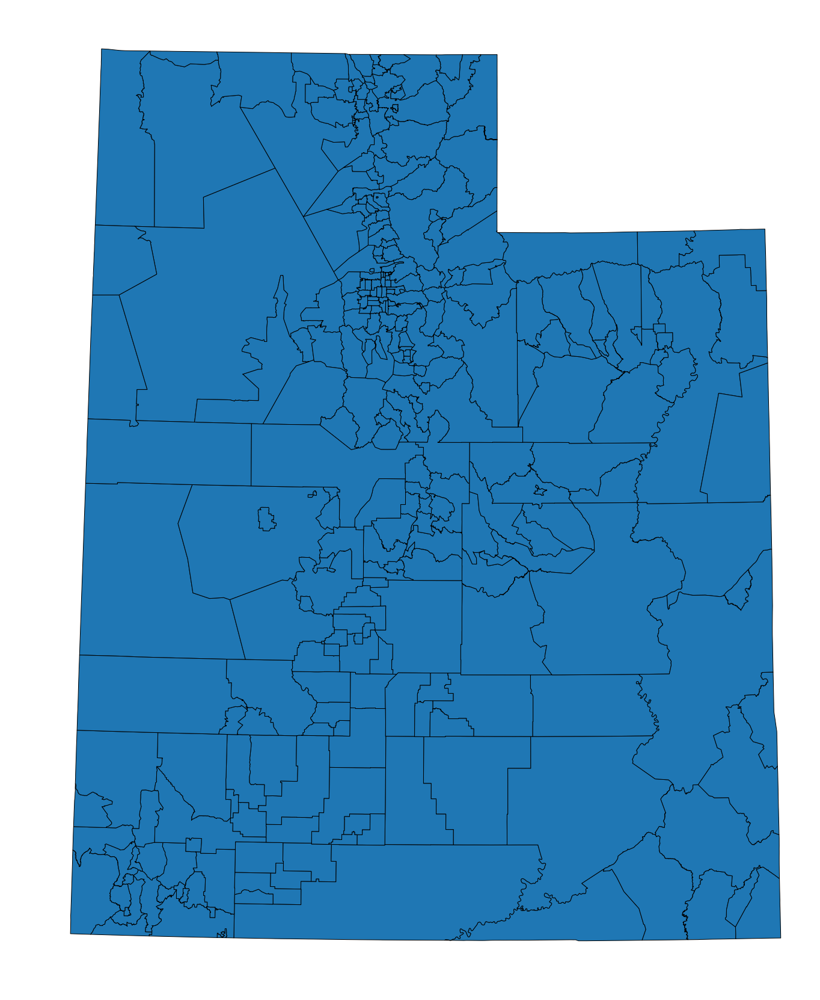

In [0]:
ax = zipcode_shapefile.plot( legend=True, figsize=(30,30), edgecolor='k');
ax.axis('off')

(219636.7955, 694490.1744999997, 4068930.5500000003, 4677636.45)

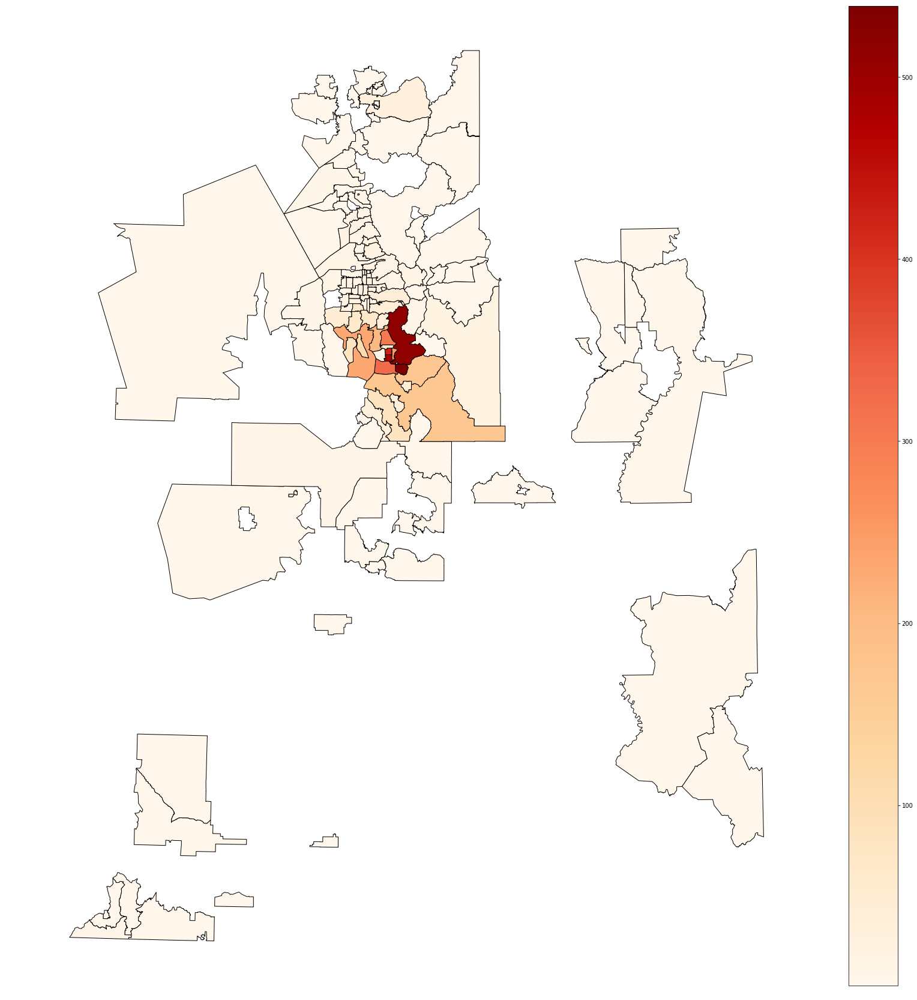

In [0]:
# Plot heat map using GeoPandas
ax = merged.plot(column='applicants', legend=True, cmap='OrRd', figsize=(30,30), edgecolor='k');
ax.axis('off')

## Calculate the geographic center of each zip code.

In [0]:
merged["center"] = merged["geometry"].centroid
merged_copy = merged.copy()
merged_copy.set_geometry("center", inplace=True)
merged.head()

,zip_code,COUNTYNBR,NAME,SYMBOL,SHAPE_Leng,SHAPE_Area,geometry,applicants,center
0,84622,20,CENTERFIELD,2,49155.163665,7.321481e+07,"POLYGON ((437052.7000000002 4326967.9, 437010....",1,POINT (431709.3080733821 4329221.471042812)
1,84634,20,GUNNISON,4,134212.044982,3.880393e+08,"POLYGON ((439755.2999999998 4343323.199999999,...",2,POINT (422856.1353973926 4340542.10492644)
2,84647,20,MOUNT PLEASANT,1,194381.915032,5.680375e+08,"POLYGON ((461166.5 4384465.5, 461518 4384291.1...",4,POINT (466915.3171367166 4371333.791938093)
3,84501,4,PRICE,2,199235.969760,6.921059e+08,"POLYGON ((518029.0999999996 4390120.6, 518038....",5,POINT (515849.5738926632 4376418.002707586)
4,84645,12,MONA,1,67998.060684,2.433350e+08,"POLYGON ((434494.3899999997 4406840.83, 433297...",3,POINT (427517.0237390847 4410666.476485889)


# Plot Map with Zip Code City Names

Below is an attempt to plot the map with corresponding city names. However many zip codes are so small that it's a bit of a mess. 

The left side of the city names begin in the center of the corresponding area, otherwise there is a blue line connecting that city name to the center of its corresponding zip code. 

21

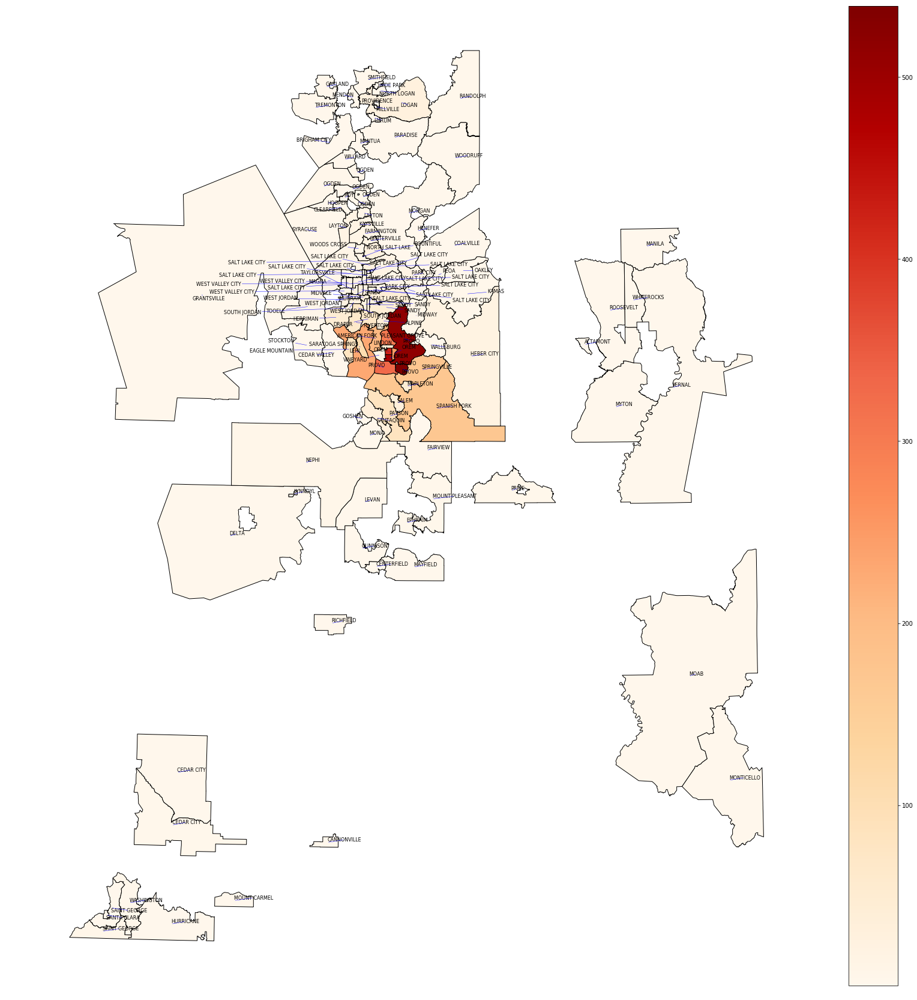

In [0]:
ax = merged.plot(figsize=(30,30), column='applicants', legend=True, cmap='OrRd', edgecolor="k")
ax.axis('off')
# merged.plot(column='applicants', legend=True, cmap='OrRd', figsize=(30,30), edgecolor='k');
texts = []

for x, y, label in zip(merged_copy.geometry.x, merged_copy.geometry.y, merged_copy["NAME"]):
    texts.append(plt.text(x, y, label, fontsize=8))

aT.adjust_text(texts, force_points=0.5, force_text=0.8, expand_points=(1,1), expand_text=(1,1), 
               arrowprops=dict(arrowstyle="-", color='blue', lw=0.5))